In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sbn


Reading the data

In [3]:
spotify_data = pd.read_csv('./data/data.csv.zip')
genre_data = pd.read_csv('./data/genres.csv')
data_year = pd.read_csv('./data/years.csv')
spotify_data.head(20)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.9820,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.2110,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.7320,['Dennis Day'],0.819,180533,0.3410,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.9610,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.1660,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.9670,['Frank Parker'],0.275,210000,0.3090,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.9570,['Phil Regan'],0.418,166693,0.1930,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
5,0.1960,1921,0.5790,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.697,395076,0.3460,0,4pyw9DVHGStUre4J6hPngr,0.168000,2,0.1300,-12.506,1,Gati Mardika,6,1921,0.0700,119.824
6,0.4060,1921,0.9960,['John McCormack'],0.518,159507,0.2030,0,5uNZnElqOS3W4fRmRYPk4T,0.000000,0,0.1150,-10.589,1,The Wearing of the Green,4,1921,0.0615,66.221
7,0.0731,1921,0.9930,['Sergei Rachmaninoff'],0.389,218773,0.0880,0,02GDntOXexBFUvSgaXLPkd,0.527000,1,0.3630,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",2,1921,0.0456,92.867
8,0.7210,1921,0.9960,['Ignacio Corsini'],0.485,161520,0.1300,0,05xDjWH9ub67nJJk82yfGf,0.151000,5,0.1040,-21.508,0,La Mañanita - Remasterizado,0,1921-03-20,0.0483,64.678
9,0.7710,1921,0.9820,['Fortugé'],0.684,196560,0.2570,0,08zfJvRLp7pjAb94MA9JmF,0.000000,8,0.5040,-16.415,1,Il Etait Syndiqué,0,1921,0.3990,109.378


In [4]:
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [6]:
data_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


Data analysis

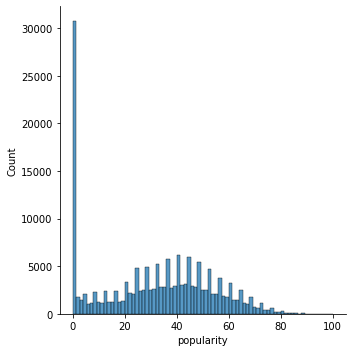

In [7]:
sbn.displot(spotify_data['popularity'])

Get year and decade

In [8]:
def get_decade(year):
    
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    
    return decade

spotify_data['decade'] = spotify_data['year'].apply(get_decade)

Music over time

/home/ericm/.local/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='decade', ylabel='count'>

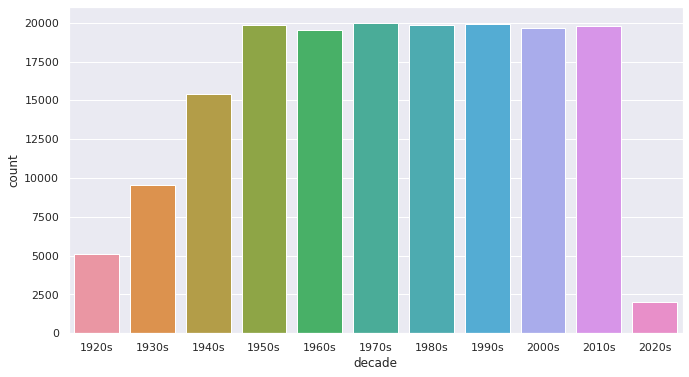

In [13]:
sbn.set(rc={'figure.figsize':(11,6)})
sbn.countplot(spotify_data['decade'])

In [34]:
import plotly.express as px
import datapane as dp


sound_features = ['danceability', 'key', 'loudness', 'mode', 'speechiness', 'valence', 'liveness', 'tempo', 'instrumentalness', 'acousticness']
fig = px.line(data_year, x='year', y=sound_features)
fig.show()

#Create a report

dp.Report(dp.Plot(fig), dp.DataTable(spotify_data)).upload(name="Music over time") 






Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Uploading files


Report successfully uploaded. View and share your report <a href='https://datapane.com/u/ericmwangii/reports/wAw2VRk/music-over-time/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/ericmwangii/reports/wAw2VRk/music-over-time/edit/' target='_blank'>here</a>.

In [29]:
fig = px.line(data_year, x='year', y='tempo')

fig.show()


Characteristics of different genres

In [25]:
genre_data.nlargest(10, 'popularity')

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
237,1,basshall,0.213167,0.81800,169799.166667,0.630167,0.000020,0.081067,-6.627833,0.134833,115.092500,0.588667,80.666667,2
2533,1,south african house,0.043833,0.84700,311854.333333,0.562333,0.130339,0.075133,-7.719000,0.050733,123.676333,0.834333,80.000000,1
2755,1,trap venezolano,0.044600,0.87700,231848.000000,0.777000,0.000035,0.086300,-4.246000,0.117000,102.020000,0.706000,80.000000,1
2778,0,turkish edm,0.008290,0.69800,186700.000000,0.719000,0.000004,0.326000,-4.923000,0.045500,120.062000,0.364000,80.000000,0
46,0,alberta hip hop,0.330000,0.88500,144000.000000,0.685000,0.000000,0.148000,-6.429000,0.062700,99.954000,0.937000,78.500000,11
536,0,chinese electropop,0.002570,0.66000,217088.000000,0.787000,0.000000,0.323000,-4.592000,0.032000,142.018000,0.199000,78.500000,1
37,0,afroswing,0.318450,0.71175,179995.375000,0.580187,0.000258,0.189950,-7.016687,0.195563,83.250125,0.676625,77.312500,11
31,0,afro soul,0.006270,0.76600,202627.000000,0.873000,0.000000,0.076400,-6.381000,0.143000,126.988000,0.743000,77.000000,11
575,1,circuit,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7
1239,1,guaracha,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7


In [33]:
top10genres = genre_data.nlargest(10, 'popularity')
fig = px.bar(top10genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

dp.Report(dp.Plot(fig), dp.DataTable(genre_data)).upload(name="Characteristics of different genres") 

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/ericmwangii/reports/9Axp9YA/characteristics-of-different-genres/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/ericmwangii/reports/9Axp9YA/characteristics-of-different-genres/edit/' target='_blank'>here</a>.

In [31]:
!datapane login --token=109fb89cc0f3e45c5c3c163ac05af077105639c3



Connected successfully to https://datapane.com as ericmwangii


Clustering Genres

In [35]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
genre_data = pd.read_csv('./data/genres.csv')


cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])

X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [36]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

/home/ericm/.local/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/home/ericm/.local/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.009s...
[t-SNE] Computed neighbors for 2973 samples in 0.496s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.185s
[t-SNE] Iteration 50: error = 81.8340988, gradient norm = 0.0273965 (50 iterations in 2.491s)
[t-SNE] Iteration 100: error = 76.3757172, gradient norm = 0.0043635 (50 iterations in 1.518s)
[t-SNE] Iteration 150: error = 76.1877670, gradient norm = 0.0018012 (50 iterations in 2.077s)
[t-SNE] Iteration 200: error = 76.1355667, gradient norm = 0.0005922 (50 iterations in 1.969s)
[t-SNE] Iteration 250: error = 76.1180954, gradient norm = 0.0005926 (50 iterations in 1.816s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.118095
[t-SNE] Iteration 300: erro

Plotting the data

In [38]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

#report
dp.Report(dp.Plot(fig), dp.DataTable(genre_data)).upload(name="Clustering genres") 





Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Report successfully uploaded. View and share your report <a href='https://datapane.com/u/ericmwangii/reports/8AVqLQk/clustering-genres/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/ericmwangii/reports/8AVqLQk/clustering-genres/edit/' target='_blank'>here</a>.

Clustering songs

In [39]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=20, verbose=2))], verbose=True)

X = spotify_data.select_dtypes(np.number)

number_cols = list(X.columns)
song_cluster_pipeline.fit(X)

[Pipeline] ............ (step 1 of 2) Processing scaler, total=  16.3s
Initialization complete
Iteration 0, inertia 1522697.2881503312
Iteration 1, inertia 1153892.7526215618
Iteration 2, inertia 1121102.6201495642
Iteration 3, inertia 1106959.944471186
Iteration 4, inertia 1094234.4661633205
Iteration 5, inertia 1087595.9275586156
Iteration 6, inertia 1083514.7044426508
Iteration 7, inertia 1080106.281398823
Iteration 8, inertia 1077185.217383703
Iteration 9, inertia 1074806.191664219
Iteration 10, inertia 1072112.961772738
Iteration 11, inertia 1069340.3723551095
Iteration 12, inertia 1068593.8799849842
Iteration 13, inertia 1068124.1766765765
Iteration 14, inertia 1067784.7647938635
Iteration 15, inertia 1067512.9127155077
Iteration 16, inertia 1067288.5473139305
Iteration 17, inertia 1067103.6393816401
Iteration 18, inertia 1066934.4005538765
Iteration 19, inertia 1066756.6390615006
Iteration 20, inertia 1066583.192587975
Iteration 21, inertia 1066419.4294346804
Iteration 22, inert

Pipeline(steps=[('scaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=20, verbose=2))],
         verbose=True)

In [40]:
song_cluster_labels = song_cluster_pipeline.predict(X)


In [41]:
spotify_data['cluster_label'] = song_cluster_labels


In [43]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']

Plotting the data

In [45]:
import plotly.express as px

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

dp.Report(dp.Plot(fig), dp.DataTable(spotify_data)).upload(name="Clustering songs") 


Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? More info <a href='https://docs.datapane.com/reports/blocks/layout-pages-and-selects' target='_blank'>here</a>

Uploading files


Report successfully uploaded. View and share your report <a href='https://datapane.com/u/ericmwangii/reports/dA9bvR3/clustering-songs/' target='_blank'>here</a>, or edit your report <a href='https://datapane.com/u/ericmwangii/reports/dA9bvR3/clustering-songs/edit/' target='_blank'>here</a>.

RECOMMENDATION SYSTEM

In [46]:
import spotipy
import os
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

CLIENT_ID = "c9d19c38a62144d78d03201eacede89b"
CLIENT_SECRET = "a10887afc25c42b59a75a7f1cee59ac1"

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id= CLIENT_ID,client_secret=CLIENT_SECRET))


def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)

In [49]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness','popularity', 'tempo']

def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        

def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [70]:
recommend_songs([{'name': 'Faucet', 'year':2014},
                {'name': 'Elizabeth', 'year': 2019},
                {'name': 'Rex Ryan', 'year': 2015},
                {'name': 'Lunchin', 'year': 2019},
                {'name': 'Dead Presidents', 'year': 2001}],  spotify_data)

/home/ericm/.local/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning:

The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names must be in the same order as they were in fit.


/home/ericm/.local/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'I Like The View', 'year': 2011, 'artists': "['Lil Wayne']"},
 {'name': "Corporate Thuggin'", 'year': 2007, 'artists': "['U.S.D.A.']"},
 {'name': 'Better Believe It (feat. Young Jeezy & Webbie)',
  'year': 2009,
  'artists': "['Boosie Badazz', 'Webbie', 'Jeezy']"},
 {'name': 'Hero', 'year': 2008, 'artists': "['Nas', 'Keri Hilson']"},
 {'name': 'Young Lady',
  'year': 2013,
  'artists': "['Kid Cudi', 'Father John Misty']"},
 {'name': 'Ashley', 'year': 2013, 'artists': "['Big Sean', 'Miguel']"},
 {'name': 'The Dope Show', 'year': 2004, 'artists': "['Marilyn Manson']"},
 {'name': 'Ignorant Sh*t',
  'year': 2007,
  'artists': "['JAY-Z', 'Beanie Sigel']"},
 {'name': 'Suffocate', 'year': 2003, 'artists': "['Motograter']"},
 {'name': 'Sick Bubblegum', 'year': 2010, 'artists': "['Rob Zombie']"}]